In [36]:
# Import Libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn import model_selection
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.neighbors import KNeighborsRegressor
from sklearn.svm import SVR
from sklearn.linear_model import LinearRegression, Ridge, RidgeCV, Lasso, LassoCV, ElasticNet, ElasticNetCV
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import BaggingRegressor, RandomForestRegressor, GradientBoostingRegressor, AdaBoostRegressor
from xgboost import XGBRegressor
from lightgbm import LGBMRegressor
from catboost import CatBoostRegressor
from ydata_profiling import ProfileReport

import warnings
warnings.filterwarnings('ignore')
pd.set_option("display.max_columns",None)
pd.set_option("display.width",500)
pd.set_option("display.float_format", lambda x: "%.4f" % x)

In [8]:
df = pd.read_csv("Hitters.csv")
df.head()

,AtBat,Hits,HmRun,Runs,RBI,Walks,Years,CAtBat,CHits,CHmRun,CRuns,CRBI,CWalks,League,Division,PutOuts,Assists,Errors,Salary,NewLeague
0,293,66,1,30,29,14,1,293,66,1,30,29,14,A,E,446,33,20,NaN,A
1,315,81,7,24,38,39,14,3449,835,69,321,414,375,N,W,632,43,10,475.0000,N
2,479,130,18,66,72,76,3,1624,457,63,224,266,263,A,W,880,82,14,480.0000,A
3,496,141,20,65,78,37,11,5628,1575,225,828,838,354,N,E,200,11,3,500.0000,N
4,321,87,10,39,42,30,2,396,101,12,48,46,33,N,E,805,40,4,91.5000,N


# Import Data and Profile Report

In [33]:
"""
What is Data Profiling?
Data profiling is the process of examining and analyzing data to gain insights
into its structure, quality, completeness, and other characteristics.
It involves the use of various techniques and tools to collect and analyze metadata, statistics,
and patterns from a dataset, including its size, type, range, format, and relationships between its variables.

Typically, data profiling involves tasks such as identifying data types, analyzing data distributions,
checking data quality, detecting data anomalies, and visualizing data patterns.
Some common tools used for data profiling include data profiling software,
data quality tools, data visualization tools, and statistical software packages.

The information gathered during data profiling can be used to make decisions about data management,
such as data cleaning, data transformation, and data integration.
Data profiling is often used as a preliminary step before data analysis, data migration, or data warehousing.
"""

'\nWhat is Data Profiling?\nData profiling is the process of examining and analyzing data to gain insights\ninto its structure, quality, completeness, and other characteristics.\nIt involves the use of various techniques and tools to collect and analyze metadata, statistics,\nand patterns from a dataset, including its size, type, range, format, and relationships between its variables.\n\nTypically, data profiling involves tasks such as identifying data types, analyzing data distributions,\nchecking data quality, detecting data anomalies, and visualizing data patterns.\nSome common tools used for data profiling include data profiling software,\ndata quality tools, data visualization tools, and statistical software packages.\n\nThe information gathered during data profiling can be used to make decisions about data management,\nsuch as data cleaning, data transformation, and data integration.\nData profiling is often used as a preliminary step before data analysis, data migration, or data

In [37]:
profile = ProfileReport(df, title="Pandas Profiling Report")
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# General Information

In [38]:
def check_df(dataframe,head=5):
  print("######################### Head #########################")
  print(dataframe.head(head))
  print("######################### Tail #########################")
  print(dataframe.tail(head))
  print("######################### Shape #########################")
  print(dataframe.shape)
  print("######################### Types #########################")
  print(dataframe.dtypes)
  print("######################### NA #########################")
  print(dataframe.isnull().sum())
  print("######################### Qurtiles #########################")
  print(dataframe.describe([0, 0.05, 0.50, 0.95, 0.99, 1]).T)

In [10]:
check_df(df)

######################### Head #########################
   AtBat  Hits  HmRun  Runs  RBI  Walks  Years  CAtBat  CHits  CHmRun  CRuns  CRBI  CWalks League Division  PutOuts  Assists  Errors   Salary NewLeague
0    293    66      1    30   29     14      1     293     66       1     30    29      14      A        E      446       33      20      NaN         A
1    315    81      7    24   38     39     14    3449    835      69    321   414     375      N        W      632       43      10 475.0000         N
2    479   130     18    66   72     76      3    1624    457      63    224   266     263      A        W      880       82      14 480.0000         A
3    496   141     20    65   78     37     11    5628   1575     225    828   838     354      N        E      200       11       3 500.0000         N
4    321    87     10    39   42     30      2     396    101      12     48    46      33      N        E      805       40       4  91.5000         N
######################### Tail 

# Analysis

In [39]:
# This function separates variables in a data frame into categorical and numerical
def grab_col_names(dataframe, cat_th=10, car_th=20):
  #Catgeorical Variable Selection
  cat_cols = [col for col in dataframe.columns if str(dataframe[col].dtypes) in ["category","object","bool"]]  
  num_but_cat = [col for col in dataframe.columns if dataframe[col].nunique() < cat_th and dataframe[col].dtypes in ["uint8","int64","float64"]]
  cat_but_car = [col for col in dataframe.columns if dataframe[col].nunique() > car_th and str(dataframe[col].dtypes) in ["category","object"]]
  cat_cols = cat_cols + num_but_cat
  cat_cols = [col for col in cat_cols if col not in cat_but_car]

  #Numerical Variable Selection
  num_cols = [col for col in dataframe.columns if dataframe[col].dtypes in ["uint8","int64","float64"]]
  num_cols = [col for col in num_cols if col not in cat_cols]

  return cat_cols, num_cols, cat_but_car, num_but_cat

In [41]:
cat_cols, num_cols, cat_but_car, num_but_cat = grab_col_names(df)

#Print Categorical and Numerical Variables
print(f"Observations: {df.shape[0]}") 
print(f"Variables: {df.shape[1]}")
print(f"Cat_cols: {len(cat_cols)}")
print(f"Num_cols: {len(num_cols)}")
print(f"Cat_but_car: {len(cat_but_car)}")
print(f"num_but_cat: {len(num_but_cat)}")

# Print which columns are categorical and numeric values
print(f"\ncat_cols: {cat_cols}")
print(f'\nnum_cols: {num_cols}')

Observations: 322
Variables: 20
Cat_cols: 3
Num_cols: 17
Cat_but_car: 0
num_but_cat: 0

cat_cols: ['League', 'Division', 'NewLeague']

num_cols: ['AtBat', 'Hits', 'HmRun', 'Runs', 'RBI', 'Walks', 'Years', 'CAtBat', 'CHits', 'CHmRun', 'CRuns', 'CRBI', 'CWalks', 'PutOuts', 'Assists', 'Errors', 'Salary']


In [42]:
def cat_summary(dataframe,col_name,plot=False):
  print(pd.DataFrame({col_name: dataframe[col_name].value_counts(),
                      'Ration': 100 * dataframe[col_name].value_counts() / len(dataframe)}))
  print("##########################################")
  if plot:
    sns.countplot(x=dataframe[col_name],data=dataframe)
    plt.show(block=True)

In [43]:
def cat_summary_df(dataframe):
  cat_cols, num_cols, cat_but_car, num_but_cat = grab_col_names(df)
  for col in cat_cols:
    cat_summary(dataframe, col, plot=True)

        League  Ration
League                
A          175 54.3478
N          147 45.6522
##########################################


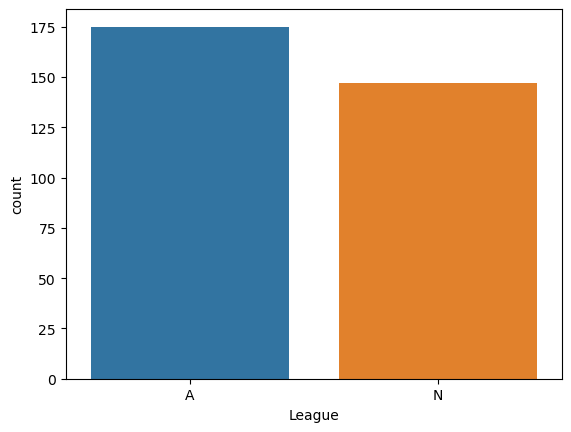

          Division  Ration
Division                  
W              165 51.2422
E              157 48.7578
##########################################


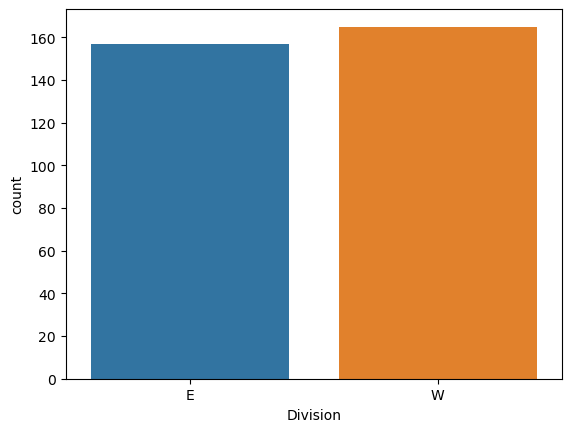

           NewLeague  Ration
NewLeague                   
A                176 54.6584
N                146 45.3416
##########################################


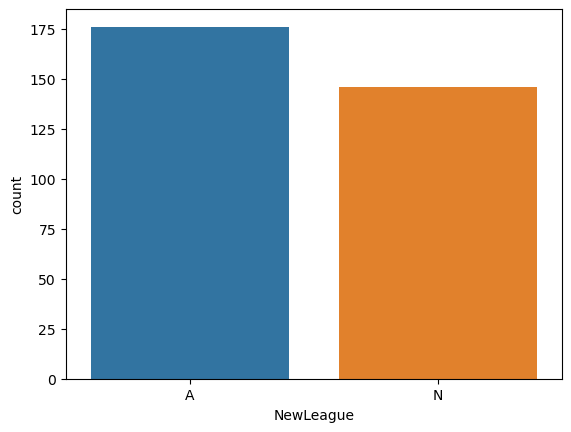

In [44]:
cat_summary_df(df)

In [45]:
def num_summary(dataframe, num_col, plot=False):
  quantiles = [0.01, 0.05, 0.10, 0.20, 0.30, 0.40, 0.50, 0.60, 0.70, 0.80, 0.90, 0.95, 0.99]
  print(dataframe[num_col].describe(quantiles).T)

  if plot:
    dataframe[num_col].hist(bins=20)
    plt.xlabel(num_col)
    plt.title(num_col)
    plt.show(block=True)

In [46]:
def num_summary_df(dataframe):
  cat_cols, num_cols, cat_but_car, num_but_cat = grab_col_names(df)
  for col in num_cols:
    num_summary(dataframe, col, plot=True)

count   322.0000
mean    380.9286
std     153.4050
min      16.0000
1%       20.4200
5%      161.0000
10%     194.1000
20%     221.8000
30%     281.3000
40%     321.8000
50%     379.5000
60%     430.2000
70%     490.0000
80%     535.6000
90%     584.9000
95%     609.9000
99%     658.5900
max     687.0000
Name: AtBat, dtype: float64


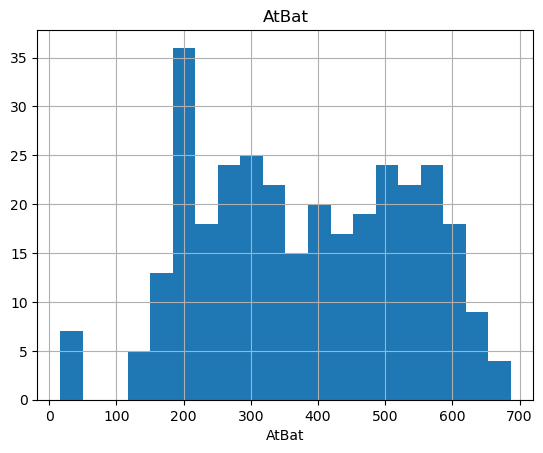

count   322.0000
mean    101.0248
std      46.4547
min       1.0000
1%        4.4200
5%       39.0000
10%      45.1000
20%      57.0000
30%      70.0000
40%      82.0000
50%      96.0000
60%     113.0000
70%     128.7000
80%     144.0000
90%     163.0000
95%     174.0000
99%     210.7900
max     238.0000
Name: Hits, dtype: float64


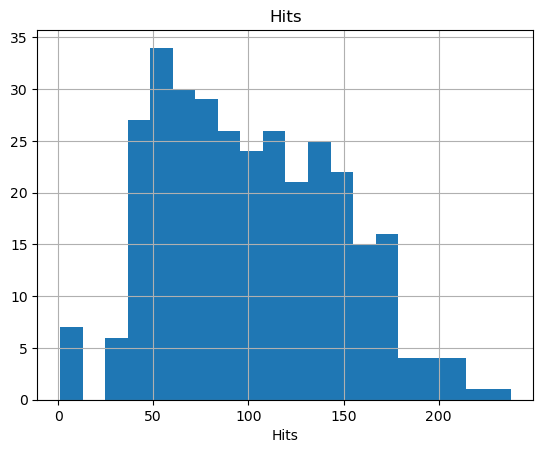

count   322.0000
mean     10.7702
std       8.7090
min       0.0000
1%        0.0000
5%        0.0000
10%       1.0000
20%       3.0000
30%       5.0000
40%       6.0000
50%       8.0000
60%      10.6000
70%      14.0000
80%      18.0000
90%      24.0000
95%      28.9500
99%      33.0000
max      40.0000
Name: HmRun, dtype: float64


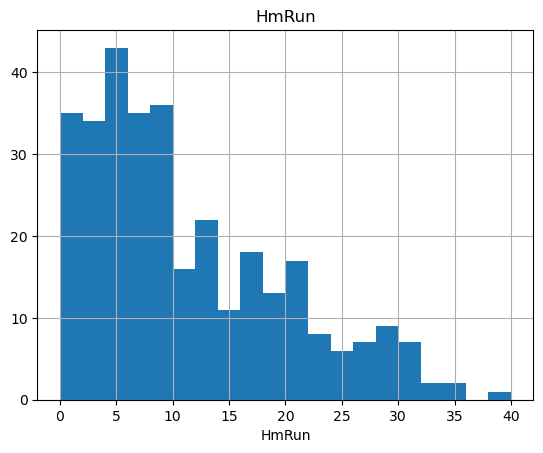

count   322.0000
mean     50.9099
std      26.0241
min       0.0000
1%        1.2100
5%       17.0000
10%      20.1000
20%      27.0000
30%      33.0000
40%      41.0000
50%      48.0000
60%      55.6000
70%      66.0000
80%      75.8000
90%      89.0000
95%      94.0000
99%     107.7900
max     130.0000
Name: Runs, dtype: float64


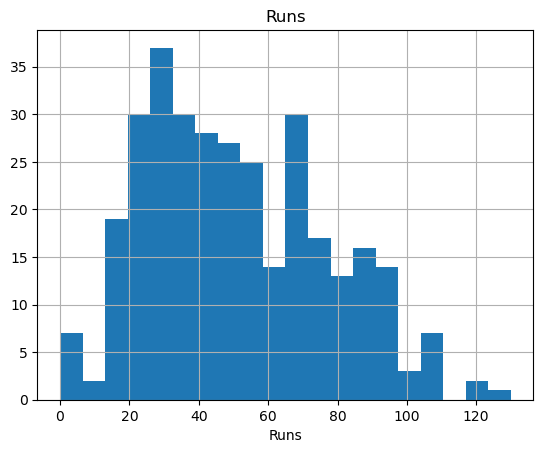

count   322.0000
mean     48.0280
std      26.1669
min       0.0000
1%        2.0000
5%       14.0000
10%      19.0000
20%      26.0000
30%      30.0000
40%      36.4000
50%      44.0000
60%      49.0000
70%      58.0000
80%      73.0000
90%      86.0000
95%      96.0000
99%     112.3700
max     121.0000
Name: RBI, dtype: float64


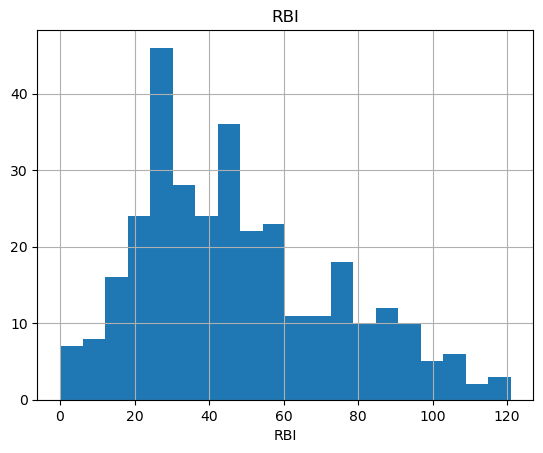

count   322.0000
mean     38.7422
std      21.6393
min       0.0000
1%        1.0000
5%       11.0500
10%      15.0000
20%      20.0000
30%      24.0000
40%      30.0000
50%      35.0000
60%      40.0000
70%      48.7000
80%      59.0000
90%      69.9000
95%      78.0000
99%      93.5800
max     105.0000
Name: Walks, dtype: float64


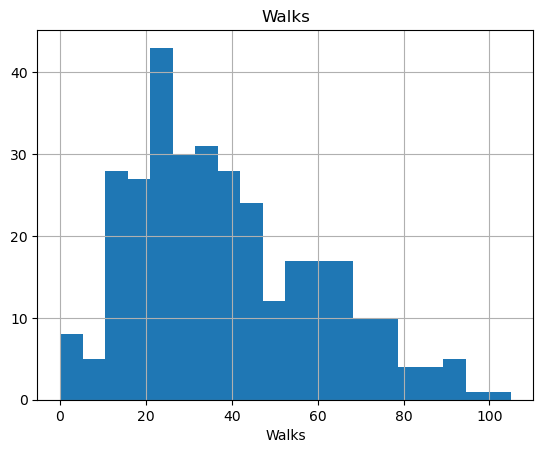

count   322.0000
mean      7.4441
std       4.9261
min       1.0000
1%        1.0000
5%        1.0000
10%       2.0000
20%       3.0000
30%       4.0000
40%       5.0000
50%       6.0000
60%       7.6000
70%      10.0000
80%      12.0000
90%      15.0000
95%      17.0000
99%      19.7900
max      24.0000
Name: Years, dtype: float64


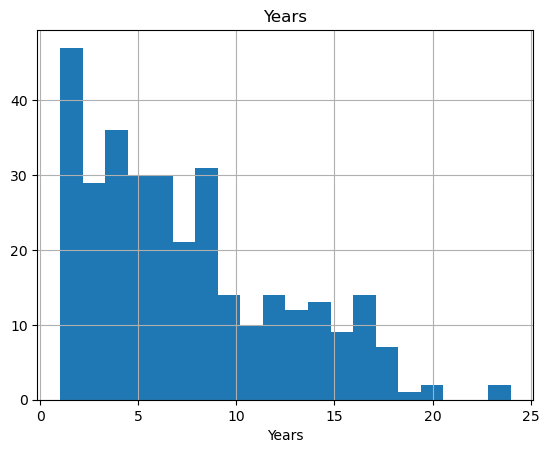

count     322.0000
mean     2648.6832
std      2324.2059
min        19.0000
1%         41.0000
5%        216.5000
10%       342.2000
20%       667.6000
30%       963.4000
40%      1402.2000
50%      1928.0000
60%      2654.0000
70%      3365.0000
80%      4483.0000
90%      6123.4000
95%      7125.6000
99%      8749.9700
max     14053.0000
Name: CAtBat, dtype: float64


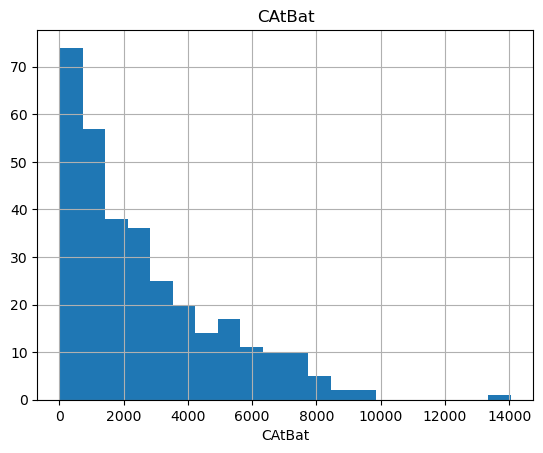

count    322.0000
mean     717.5714
std      654.4726
min        4.0000
1%         9.8400
5%        54.0000
10%       86.0000
20%      164.6000
30%      238.0000
40%      355.8000
50%      508.0000
60%      708.2000
70%      911.1000
80%     1229.2000
90%     1659.6000
95%     2017.1500
99%     2500.3400
max     4256.0000
Name: CHits, dtype: float64


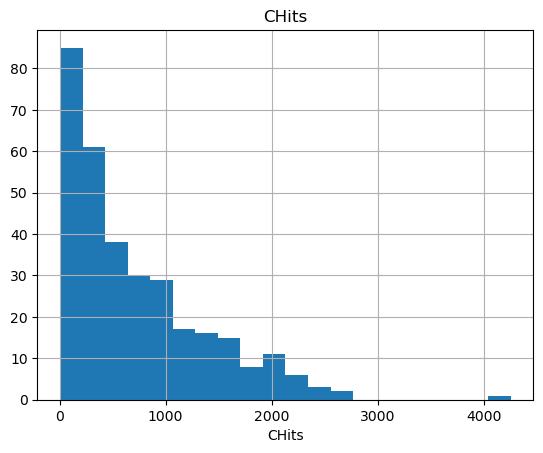

count   322.0000
mean     69.4907
std      86.2661
min       0.0000
1%        0.0000
5%        2.0000
10%       4.0000
20%      10.2000
30%      16.3000
40%      27.4000
50%      37.5000
60%      51.2000
70%      72.4000
80%     103.8000
90%     194.9000
95%     265.6500
99%     373.1200
max     548.0000
Name: CHmRun, dtype: float64


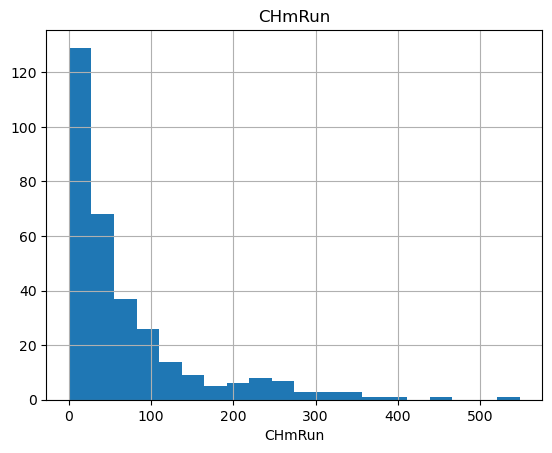

count    322.0000
mean     358.7950
std      334.1059
min        1.0000
1%         3.6300
5%        27.0000
10%       38.1000
20%       80.4000
30%      117.3000
40%      181.0000
50%      247.0000
60%      333.0000
70%      443.4000
80%      627.2000
90%      895.7000
95%     1032.3000
99%     1174.3700
max     2165.0000
Name: CRuns, dtype: float64


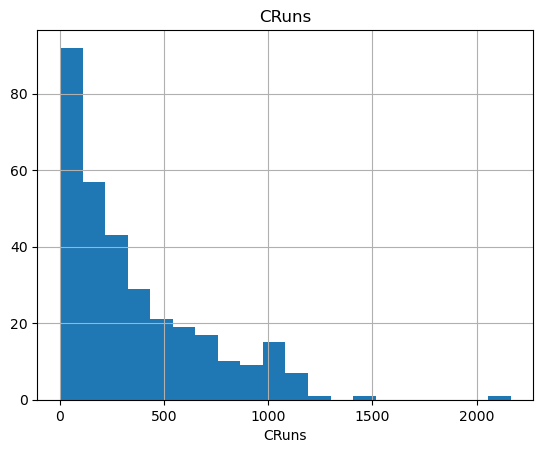

count    322.0000
mean     330.1180
std      333.2196
min        0.0000
1%         4.6300
5%        22.0500
10%       34.1000
20%       70.2000
30%      106.3000
40%      149.0000
50%      220.5000
60%      303.6000
70%      379.1000
80%      496.2000
90%      861.6000
95%     1071.7500
99%     1310.8500
max     1659.0000
Name: CRBI, dtype: float64


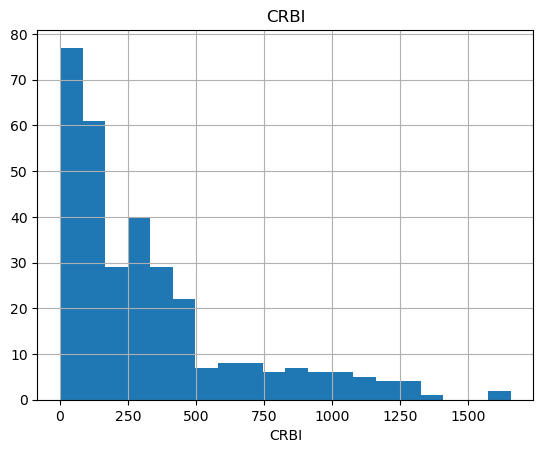

count    322.0000
mean     260.2391
std      267.0581
min        0.0000
1%         4.0000
5%        15.0500
10%       30.1000
20%       55.0000
30%       82.0000
40%      117.4000
50%      170.5000
60%      226.6000
70%      300.7000
80%      421.0000
90%      643.9000
95%      817.6000
99%     1139.1400
max     1566.0000
Name: CWalks, dtype: float64


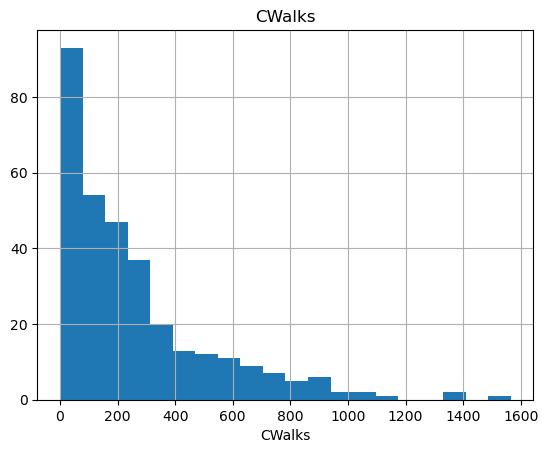

count    322.0000
mean     288.9379
std      280.7046
min        0.0000
1%         0.0000
5%        33.2000
10%       62.2000
20%       99.6000
30%      132.0000
40%      167.0000
50%      212.0000
60%      257.4000
70%      303.0000
80%      365.8000
90%      685.6000
95%      910.6500
99%     1301.1900
max     1378.0000
Name: PutOuts, dtype: float64


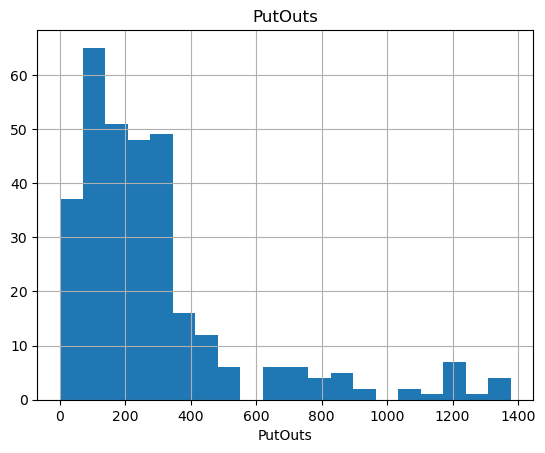

count   322.0000
mean    106.9130
std     136.8549
min       0.0000
1%        0.0000
5%        0.0000
10%       2.0000
20%       5.2000
30%       9.0000
40%      15.4000
50%      39.5000
60%      76.8000
70%     134.8000
80%     210.8000
90%     353.3000
95%     431.4500
99%     478.1600
max     492.0000
Name: Assists, dtype: float64


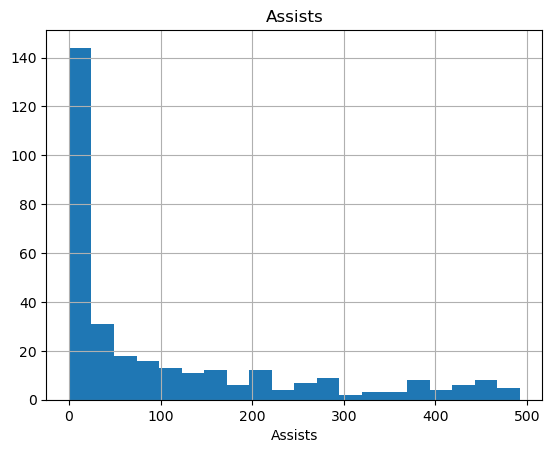

count   322.0000
mean      8.0404
std       6.3684
min       0.0000
1%        0.0000
5%        0.0000
10%       1.0000
20%       3.0000
30%       4.0000
40%       5.0000
50%       6.0000
60%       8.0000
70%      10.0000
80%      13.0000
90%      17.0000
95%      20.0000
99%      25.7900
max      32.0000
Name: Errors, dtype: float64


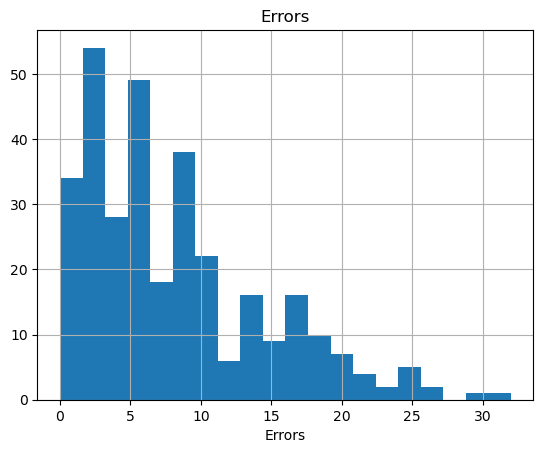

count    263.0000
mean     535.9259
std      451.1187
min       67.5000
1%        70.0000
5%        86.6000
10%      100.0000
20%      155.0000
30%      221.0000
40%      300.0000
50%      425.0000
60%      538.0000
70%      700.0000
80%      809.0000
90%     1048.6666
95%     1346.0000
99%     2032.8865
max     2460.0000
Name: Salary, dtype: float64


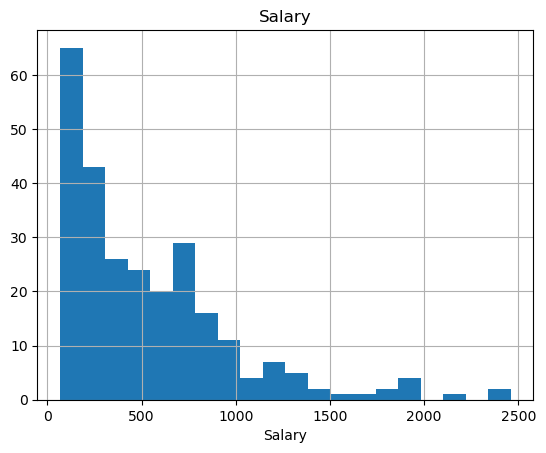

In [47]:
num_summary_df(df)

In [19]:
# Histogram
def plot_num_summary(dataframe):
  cat_cols, num_cols, cat_but_car, num_but_cat = grab_col_names(dataframe)
  plt.figure(figsize=(16,16))
  for index, col in enumerate(num_cols):
    plt.subplot(6,3,index+1)
    plt.tight_layout()
    dataframe[col].hist(bins=20)
    plt.title(col)

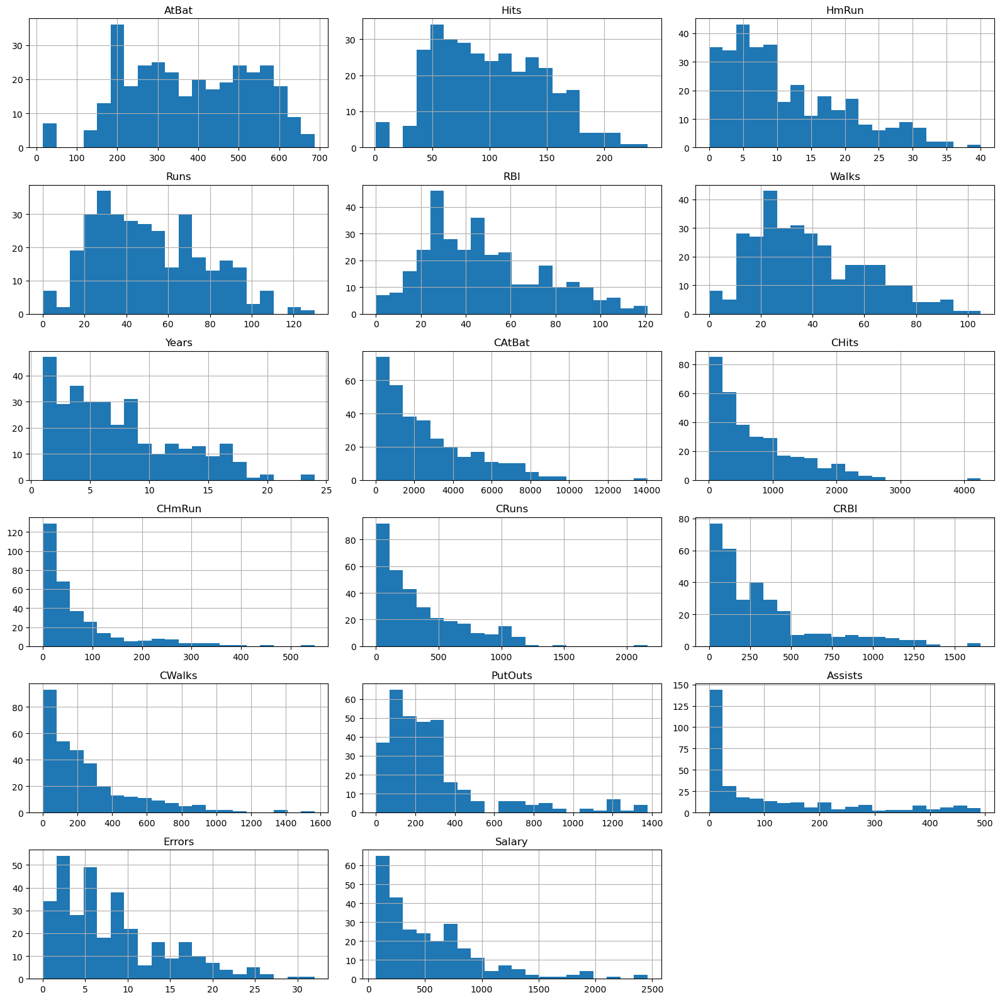

In [22]:
plot_num_summary(df)

In [23]:
# Target Analysis
def target_summary_with_cat(dataframe, target, categorical_col):
  print(pd.DataFrame({"Target Mean": dataframe.groupby(categorical_col)[target].mean()}))
  print("#############################################")

In [24]:
def target_summary_with_cat_df(dataframe, target):
  cat_cols, num_cols, cat_but_car, num_but_cat = grab_col_names(df)
  for col in cat_cols:
    target_summary_with_cat(dataframe, target, col)

In [25]:
target_summary_with_cat_df(df,"Salary")

        Target Mean
League             
A          541.9995
N          529.1175
#############################################
          Target Mean
Division             
E            624.2714
W            450.8769
#############################################
           Target Mean
NewLeague             
A             537.1130
N             534.5539
#############################################


# Dependent Variable

In [26]:
def exam_dependent_variable(dataframe, target):
  plt.figure(figsize=(16,4))
  plt.subplot(121)
  dataframe[target].hist(bins=100)
  plt.title(target + ", Histogram")
  plt.subplot(122)
  np.log1p(dataframe[target]).hist(bins=50)
  plt.title(target + ", Logaritmic Histogram")

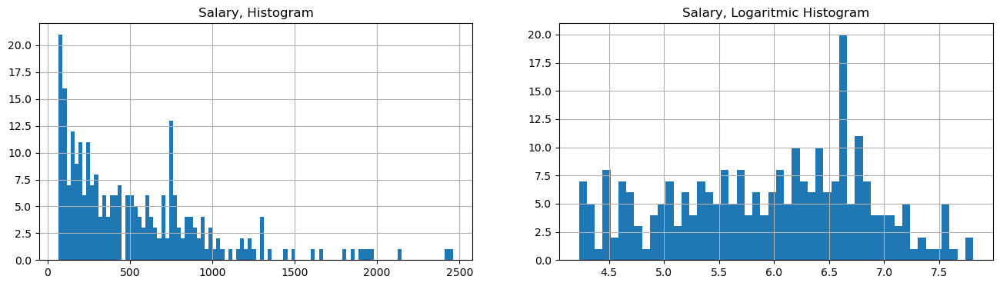

In [27]:
exam_dependent_variable(df, "Salary")

# Corretation

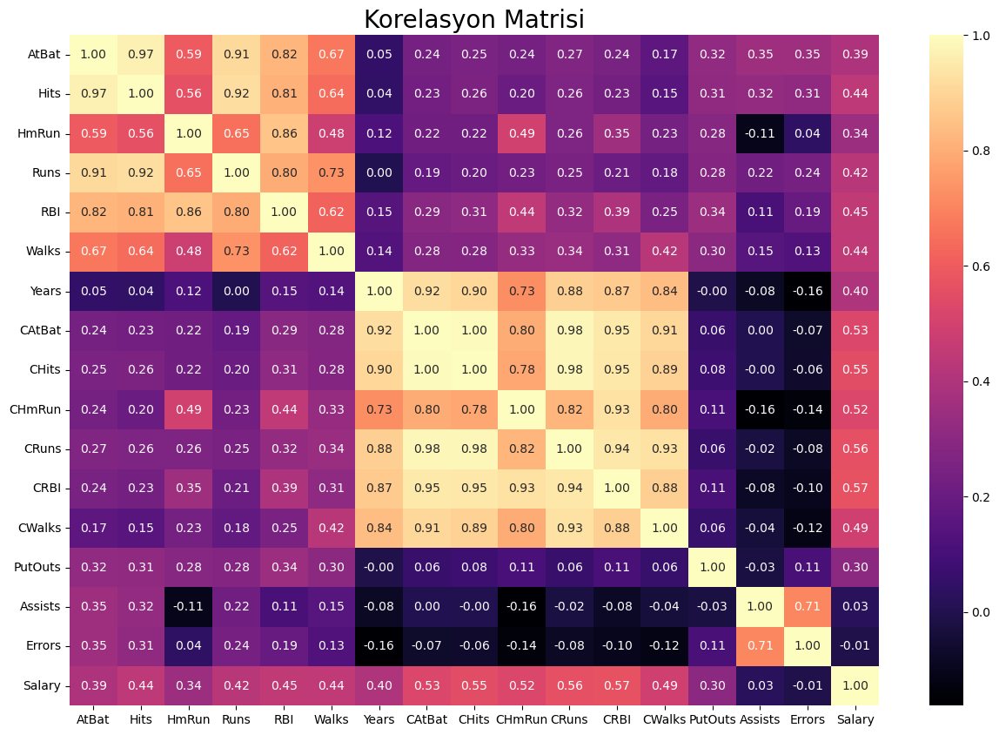

In [30]:
numerical_df = df.select_dtypes(include=['float64', 'int64'])
correlation_matrix = numerical_df.corr()

# Isı haritası
plt.figure(figsize=(15, 10))
sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap="magma")
plt.title("Korelasyon Matrisi", fontsize=20)
plt.show()

# EDA 

In [31]:
import scipy.stats as stats
def exploratory_data(dataframe):
  import warnings
  warnings.filterwarnings('ignore')
  cat_cols, num_cols, cat_but_car, num_but_cat = grab_col_names(dataframe)
  fig,ax = plt.subplots(len(num_cols),3,figsize=(20,90))
  # sns.set(font_scale=2)
  for index, col in enumerate(num_cols):
    sns.distplot(dataframe[col],ax=ax[index,0])
    sns.boxplot(dataframe[col],ax=ax[index,1])
    stats.probplot(dataframe[col],plot=ax[index,2])
  fig.tight_layout()
  fig.subplots_adjust(top=0.95)
  plt.suptitle("Visualizing Continuous Columns")

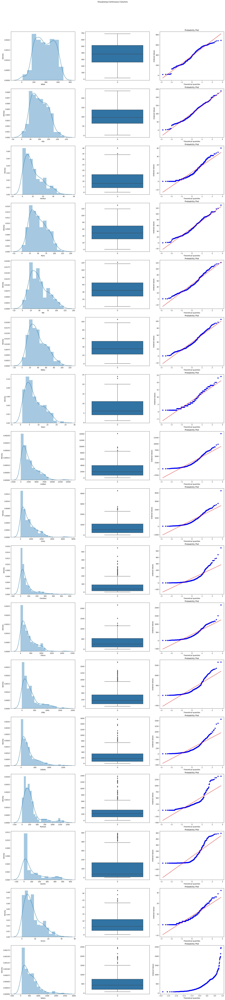

In [32]:
exploratory_data(df)

# Outlier Analysis and Missing Value Analysis

In [48]:
def outlier_thresholds(dataframe,col_name,q1=0.10,q3=0.90):
  quartile1 = dataframe[col_name].quantile(q1)
  quartile3 = dataframe[col_name].quantile(q3)
  interquartile_range = quartile3 - quartile1
  low_limit = quartile1 - 1.5 * interquartile_range
  up_limit = quartile3 + 1.5 * interquartile_range
  return low_limit,up_limit

In [49]:
def check_outlier(dataframe, col_name):
  low_limit,up_limit = outlier_thresholds(dataframe,col_name)
  if dataframe[(dataframe[col_name] > up_limit) | (dataframe[col_name] < low_limit)].any(axis=None):
    return True
  else:
    return False

In [50]:
def replace_with_thresholds(dataframe, col_name):
  low_limit, up_limit = outlier_thresholds(dataframe, col_name)
  dataframe.loc[(dataframe[col_name] < low_limit), col_name] = low_limit
  dataframe.loc[(dataframe[col_name] > up_limit), col_name] = up_limit

In [51]:
def solve_outliers(dataframe, target):
  cat_cols, num_cols, cat_but_car, num_but_cat = grab_col_names(dataframe)
  for col in num_cols:
    if col!=target:
      print(col, check_outlier(dataframe, col))
      if check_outlier(dataframe, col):
        replace_with_thresholds(dataframe, col)

In [52]:
solve_outliers(df, "Salary")

AtBat False
Hits False
HmRun False
Runs False
RBI False
Walks False
Years False
CAtBat False
CHits True
CHmRun True
CRuns False
CRBI False
CWalks True
PutOuts False
Assists False
Errors False


In [53]:
def check_outlier_df(dataframe, target):
  cat_cols, num_cols, cat_but_car, num_but_cat = grab_col_names(dataframe)
  for col in num_cols:
    if col!=target:
      print(col, check_outlier(dataframe, col))

In [54]:
check_outlier_df(df, "Salary")

AtBat False
Hits False
HmRun False
Runs False
RBI False
Walks False
Years False
CAtBat False
CHits False
CHmRun False
CRuns False
CRBI False
CWalks False
PutOuts False
Assists False
Errors False


In [55]:
def missing_value_table(dataframe, na_name=False):
  na_columns = [col for col in dataframe.columns if dataframe[col].isnull().sum() > 0]
  n_miss = dataframe[na_columns].isnull().sum().sort_values(ascending=False)
  ratio = (dataframe[na_columns].isnull().sum() / dataframe.shape[0] * 100).sort_values(ascending=False)
  missing_df = pd.concat([n_miss, np.round(ratio, 2)], axis=1, keys=["n_miss","ratio"])
  print(missing_df, end="\n")
  if na_name:
    return na_columns

In [56]:
na_columns = missing_value_table(df, na_name=True)

        n_miss   ratio
Salary      59 18.3200


In [57]:
df["Salary"].fillna(df["Salary"].median(), inplace=True)

In [58]:
df.isnull().sum()

AtBat        0
Hits         0
HmRun        0
Runs         0
RBI          0
Walks        0
Years        0
CAtBat       0
CHits        0
CHmRun       0
CRuns        0
CRBI         0
CWalks       0
League       0
Division     0
PutOuts      0
Assists      0
Errors       0
Salary       0
NewLeague    0
dtype: int64

In [59]:
def rare_analyser(dataframe, target):
  cat_cols, num_cols, cat_but_car, num_but_cat = grab_col_names(dataframe)
  for col in cat_cols:
    print(col, ":", len(dataframe[col].value_counts()))
    print(pd.DataFrame({"COUNT": dataframe[col].value_counts(),
                        "Ratio": dataframe[col].value_counts() / len(dataframe),
                        "TARGET_MEAN": dataframe.groupby(col)[target].mean()}), end="\n\n\n")

In [60]:
rare_analyser(df, "Salary")

League : 2
        COUNT  Ratio  TARGET_MEAN
League                           
A         175 0.5435     517.9311
N         147 0.4565     512.8270


Division : 2
          COUNT  Ratio  TARGET_MEAN
Division                           
E           157 0.4876     588.7325
W           165 0.5124     446.0152


NewLeague : 2
           COUNT  Ratio  TARGET_MEAN
NewLeague                           
A            176 0.5466     514.8178
N            146 0.4534     516.5450




In [61]:
def rare_encoder(dataframe, rare_prec):
  temp_df = dataframe.copy()
  rare_columns = [col for col in temp_df.columns if temp_df[col].dtypes in ["category","object"]
                  and (temp_df[col].value_counts() / len(temp_df) < rare_prec).any(axis=None)]
  for var in rare_columns:
    tmp = temp_df[var].value_counts() / len(temp_df)
    rare_labels = tmp[tmp < rare_prec].index
    temp_df[var] = np.where(temp_df[var].isin(rare_labels), "Rare", temp_df[var])
  return temp_df

In [62]:
new_df = rare_encoder(df, 0.01)

# Feature Extraction

In [63]:
cat_cols, num_cols, cat_but_car, num_but_cat = grab_col_names(df)
new_num_cols=[col for col in num_cols if col!="Salary"]
df[new_num_cols]=df[new_num_cols]+0.0000000001
df['NEW_Hits'] = df['Hits'] / df['CHits'] + df['Hits']
df['NEW_RBI'] = df['RBI'] / df['CRBI']
df['NEW_Walks'] = df['Walks'] / df['CWalks']
df['NEW_PutOuts'] = df['PutOuts'] * df['Years']
df["Hits_Success"] = (df["Hits"] / df["AtBat"]) * 100
df["NEW_CRBI*CATBAT"] = df['CRBI'] * df['CAtBat']
df["NEW_RBI"] = df["RBI"] / df["CRBI"]
df["NEW_Chits"] = df["CHits"] / df["Years"]
df["NEW_CHmRun"] = df["CHmRun"] * df["Years"]
df["NEW_CRuns"] = df["CRuns"] / df["Years"]
df["NEW_Chits"] = df["CHits"] * df["Years"]
df["NEW_RW"] = df["RBI"] * df["Walks"]
df["NEW_RBWALK"] = df["RBI"] / df["Walks"]
df["NEW_CH_CB"] = df["CHits"] / df["CAtBat"]
df["NEW_CHm_CAT"] = df["CHmRun"] / df["CAtBat"]
df['NEW_Diff_Atbat'] = df['AtBat'] - (df['CAtBat'] / df['Years'])
df['NEW_Diff_Hits'] = df['Hits'] - (df['CHits'] / df['Years'])
df['NEW_Diff_HmRun'] = df['HmRun'] - (df['CHmRun'] / df['Years'])
df['NEW_Diff_Runs'] = df['Runs'] - (df['CRuns'] / df['Years'])
df['NEW_Diff_RBI'] = df['RBI'] - (df['CRBI'] / df['Years'])
df['NEW_Diff_Walks'] = df['Walks'] - (df['CWalks'] / df['Years'])

In [64]:
df.head()

,AtBat,Hits,HmRun,Runs,RBI,Walks,Years,CAtBat,CHits,CHmRun,CRuns,CRBI,CWalks,League,Division,PutOuts,Assists,Errors,Salary,NewLeague,NEW_Hits,NEW_RBI,NEW_Walks,NEW_PutOuts,Hits_Success,NEW_CRBI*CATBAT,NEW_Chits,NEW_CHmRun,NEW_CRuns,NEW_RW,NEW_RBWALK,NEW_CH_CB,NEW_CHm_CAT,NEW_Diff_Atbat,NEW_Diff_Hits,NEW_Diff_HmRun,NEW_Diff_Runs,NEW_Diff_RBI,NEW_Diff_Walks
0,293.0000,66.0000,1.0000,30.0000,29.0000,14.0000,1.0000,293.0000,66.0000,1.0000,30.0000,29.0000,14.0000,A,E,446.0000,33.0000,20.0000,425.0000,A,67.0000,1.0000,1.0000,446.0000,22.5256,8497.0000,66.0000,1.0000,30.0000,406.0000,2.0714,0.2253,0.0034,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
1,315.0000,81.0000,7.0000,24.0000,38.0000,39.0000,14.0000,3449.0000,835.0000,69.0000,321.0000,414.0000,375.0000,N,W,632.0000,43.0000,10.0000,475.0000,N,81.0970,0.0918,0.1040,8848.0000,25.7143,1427886.0000,11690.0000,966.0000,22.9286,1482.0000,0.9744,0.2421,0.0200,68.6429,21.3571,2.0714,1.0714,8.4286,12.2143
2,479.0000,130.0000,18.0000,66.0000,72.0000,76.0000,3.0000,1624.0000,457.0000,63.0000,224.0000,266.0000,263.0000,A,W,880.0000,82.0000,14.0000,480.0000,A,130.2845,0.2707,0.2890,2640.0000,27.1399,431984.0000,1371.0000,189.0000,74.6667,5472.0000,0.9474,0.2814,0.0388,-62.3333,-22.3333,-3.0000,-8.6667,-16.6667,-11.6667
3,496.0000,141.0000,20.0000,65.0000,78.0000,37.0000,11.0000,5628.0000,1575.0000,225.0000,828.0000,838.0000,354.0000,N,E,200.0000,11.0000,3.0000,500.0000,N,141.0895,0.0931,0.1045,2200.0000,28.4274,4716264.0000,17325.0000,2475.0000,75.2727,2886.0000,2.1081,0.2799,0.0400,-15.6364,-2.1818,-0.4545,-10.2727,1.8182,4.8182
4,321.0000,87.0000,10.0000,39.0000,42.0000,30.0000,2.0000,396.0000,101.0000,12.0000,48.0000,46.0000,33.0000,N,E,805.0000,40.0000,4.0000,91.5000,N,87.8614,0.9130,0.9091,1610.0000,27.1028,18216.0000,202.0000,24.0000,24.0000,1260.0000,1.4000,0.2551,0.0303,123.0000,36.5000,4.0000,15.0000,19.0000,13.5000


In [65]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 322 entries, 0 to 321
Data columns (total 39 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   AtBat            322 non-null    float64
 1   Hits             322 non-null    float64
 2   HmRun            322 non-null    float64
 3   Runs             322 non-null    float64
 4   RBI              322 non-null    float64
 5   Walks            322 non-null    float64
 6   Years            322 non-null    float64
 7   CAtBat           322 non-null    float64
 8   CHits            322 non-null    float64
 9   CHmRun           322 non-null    float64
 10  CRuns            322 non-null    float64
 11  CRBI             322 non-null    float64
 12  CWalks           322 non-null    float64
 13  League           322 non-null    object 
 14  Division         322 non-null    object 
 15  PutOuts          322 non-null    float64
 16  Assists          322 non-null    float64
 17  Errors          

# Encoding

In [66]:
def label_encoding(dataframe, binary_col):
  labelencoder = LabelEncoder()
  dataframe[binary_col] = labelencoder.fit_transform(dataframe[binary_col])
  return dataframe

In [67]:
def label_encoder(dataframe):
  binary_cols = [col for col in dataframe.columns if dataframe[col].dtypes == "O" and dataframe[col].nunique() == 2]
  for col in binary_cols:
      dataframe = label_encoding(dataframe, col)
  return dataframe

In [68]:
df = label_encoder(df)

In [69]:
def one_hot_encoder(dataframe, target, drop_first=False):
    binary_cols = [col for col in dataframe.columns if dataframe[col].dtypes == "O" and dataframe[col].nunique() == 2]
    cat_cols, num_cols, cat_but_car, num_but_cat = grab_col_names(df)
    cat_cols = [col for col in cat_cols if col not in binary_cols and col not in [target]]
    dataframe = pd.get_dummies(dataframe, columns=cat_cols, drop_first=drop_first)
    return dataframe

In [70]:
df = one_hot_encoder(df, "Salary", drop_first=True)

In [71]:
def apply_standardScaler(dataframe, target):  
  cat_cols, num_cols, cat_but_car, num_but_cat = grab_col_names(dataframe)
  num_cols = [col for col in num_cols if col not in [target]]
  scaler = StandardScaler()
  dataframe[num_cols] = scaler.fit_transform(dataframe[num_cols])

In [72]:
apply_standardScaler(df, "Salary")

In [73]:
df.head()

,AtBat,Hits,HmRun,Runs,RBI,Walks,Years,CAtBat,CHits,CHmRun,CRuns,CRBI,CWalks,League,Division,PutOuts,Assists,Errors,Salary,NewLeague,NEW_Hits,NEW_RBI,NEW_Walks,NEW_PutOuts,Hits_Success,NEW_CRBI*CATBAT,NEW_Chits,NEW_CHmRun,NEW_CRuns,NEW_RW,NEW_RBWALK,NEW_CH_CB,NEW_CHm_CAT,NEW_Diff_Atbat,NEW_Diff_Hits,NEW_Diff_HmRun,NEW_Diff_Runs,NEW_Diff_RBI,NEW_Diff_Walks
0,-0.5741,-0.7551,-1.1236,-0.8047,-0.7283,-1.1452,-1.3102,-1.0151,-1.0019,-0.8028,-0.9856,-0.9051,-0.9235,0,0,0.5604,-0.5409,1.8809,425.0000,0,-0.7409,2.2112,2.2814,-0.5811,-0.9558,-0.5812,-0.6892,-0.5669,-0.6323,-0.9006,0.8281,-1.4124,-1.3376,-0.4971,-0.4368,-0.5181,-0.4031,-0.5321,-0.5635
1,-0.4304,-0.4317,-0.4336,-1.0356,-0.3838,0.0119,1.3329,0.3449,0.1819,-0.0033,-0.1133,0.2521,0.4304,1,1,1.2240,-0.4677,0.3082,475.0000,1,-0.4368,-0.7919,-0.7612,2.2934,-0.0763,-0.0652,0.2923,0.1002,-0.9652,-0.3630,-0.5578,-0.7542,-0.2819,0.0969,0.2002,-0.1058,-0.3454,-0.0455,0.3089
2,0.6403,0.6247,0.8314,0.5808,0.9175,1.7244,-0.9036,-0.4416,-0.4000,-0.0739,-0.4041,-0.1927,0.0104,0,1,2.1089,-0.1823,0.9373,480.0000,0,0.6244,-0.2004,-0.1331,0.1695,0.3169,-0.4272,-0.5790,-0.4369,1.4699,1.6306,-0.5919,0.7817,0.9135,-1.0365,-1.1029,-1.1153,-0.8706,-1.4942,-1.3968
3,0.7513,0.8619,1.0614,0.5423,1.1472,-0.0806,0.7230,1.2839,1.3210,1.8308,1.4065,1.5265,0.3517,1,0,-0.3173,-0.7019,-0.7927,500.0000,1,0.8575,-0.7876,-0.7595,0.0190,0.6721,1.1302,0.7681,1.1433,1.4985,0.3385,0.8744,0.7210,0.9889,-0.6324,-0.5018,-0.6086,-0.9572,-0.4271,-0.2194
4,-0.3913,-0.3024,-0.0886,-0.4584,-0.2307,-0.4046,-1.1069,-0.9707,-0.9480,-0.6735,-0.9317,-0.8540,-0.8523,1,0,1.8413,-0.4897,-0.6354,91.5000,1,-0.2908,1.9237,1.9727,-0.1828,0.3067,-0.5776,-0.6777,-0.5510,-0.9147,-0.4739,-0.0201,-0.2481,0.3733,0.5673,0.6519,0.2781,0.4059,0.5648,0.4007


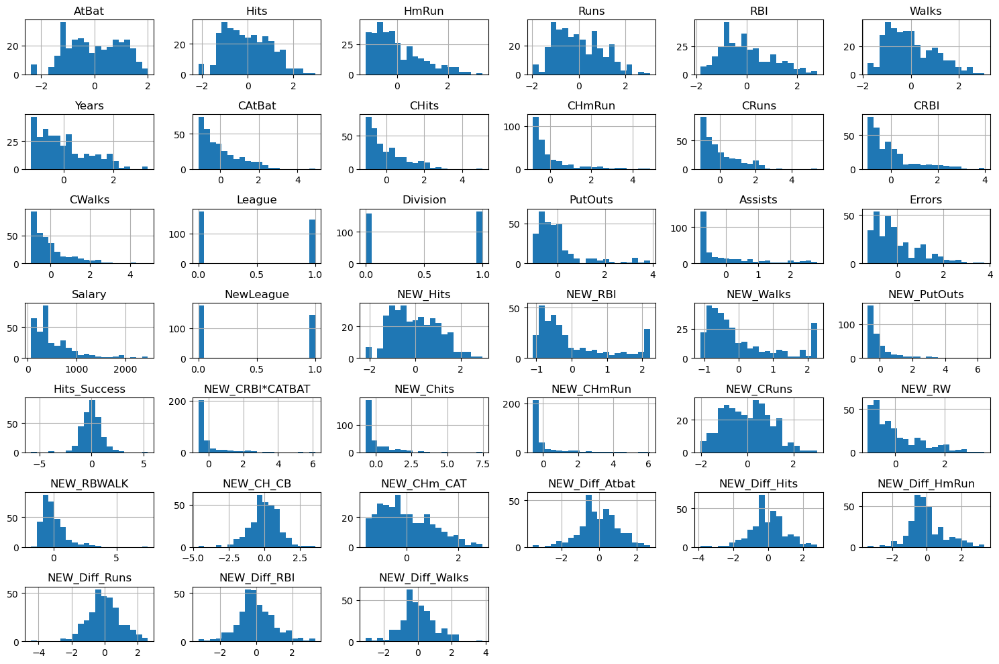

# Model

In [81]:
def create_base_model(dataframe, target, models=None, plot=False, save_results=False):
    if models is None:
        models = {'LR': LinearRegression(),
                  'Ridge': Ridge(),
                  'Lasso': Lasso(),
                  'ElasticNet': ElasticNet(),
                  'SVR': SVR(),
                  'KNN': KNeighborsRegressor(),
                  'CART': DecisionTreeRegressor(),
                  'RF': RandomForestRegressor(),
                  'AdaBoost': AdaBoostRegressor(),
                  'BGTrees': BaggingRegressor(bootstrap_features=True),
                  'GBM': GradientBoostingRegressor(),
                  'XGBoost': XGBRegressor(objective='reg:squarederror'),
                  'LightGBM': LGBMRegressor(),
                  'CatBoost': CatBoostRegressor(verbose=False)}

    names = []
    train_rmse_results = []
    test_rmse_results = []
    train_r2_scores = []
    test_r2_scores = []
    X = dataframe.drop(target, axis=1)
    y = dataframe[target]
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=17)
  
    print("###################### Mean and Std(Target Variable) ######################")
    print("Mean: ", dataframe[target].mean())
    print("Std: ", dataframe[target].std())
    print("###################### Model Results ######################")

    for name, regressor in models.items():
        regressor.fit(X_train, y_train)
        y_train_pred = regressor.predict(X_train)
        y_test_pred = regressor.predict(X_test)

        # RMSE
        train_rmse_result = np.sqrt(mean_squared_error(y_train, y_train_pred))
        test_rmse_result = np.sqrt(mean_squared_error(y_test, y_test_pred))
        train_rmse_results.append(train_rmse_result)
        test_rmse_results.append(test_rmse_result)

        # score
        train_r2_score = regressor.score(X_train, y_train)
        test_r2_score = regressor.score(X_test, y_test)
        train_r2_scores.append(train_r2_score)
        test_r2_scores.append(test_r2_score)

        # Model names
        names.append(name)
  
    model_results = pd.DataFrame({'Model_Names': names,
                                  'RMSE_Train': train_rmse_results,
                                  'RMSE_Test': test_rmse_results,
                                  'R2_score_Train': train_r2_scores,
                                  'R2_score_Test': test_r2_scores
                                  }).set_index("Model_Names")
    model_results = model_results.sort_values(by="RMSE_Test", ascending=True)
    print(model_results)

    if plot:
        plt.figure(figsize=(15, 12))
        plt.barh(model_results.index, model_results['RMSE_Test'], color="r")
        plt.xlabel('RMSE Values')
        plt.ylabel('Model Names')
        plt.title('RMSE_Test for All Models')
        plt.show()

    if save_results:
        model_results.to_csv("model_results.csv")
  
    return model_results


###################### Mean and Std(Target Variable) ######################
Mean:  515.600953416149
Std:  409.81745894162634
###################### Model Results ######################
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000148 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2661
[LightGBM] [Info] Number of data points in the train set: 257, number of used features: 38
[LightGBM] [Info] Start training from score 504.127506
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No

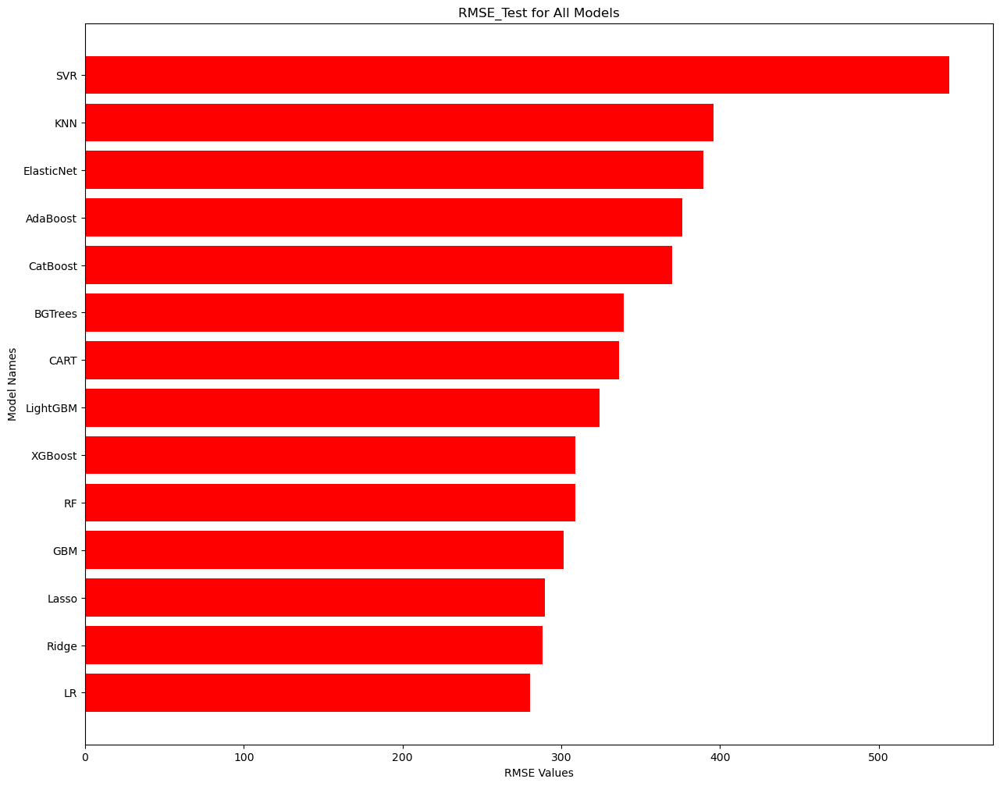

In [82]:
model_results = create_base_model(df, "Salary", plot=True, save_results=True)

In [83]:
def create_model_tuned(dataframe, target, plot=True, save_results=True):
  names = []
  train_rmse_results = []
  test_rmse_results = []
  train_r2_scores = []
  test_r2_scores = []
  best_params = []

  X = dataframe.drop(target, axis=1)
  y = dataframe[target]
  X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=17)

  ridge_params = {"alpha": 10**np.linspace(10,-2,100)*0.5}

  lasso_params = {"alpha": 10**np.linspace(10,-2,100)*0.5}

  enet_params = {"alpha": 10**np.linspace(10,-2,100)*0.5}

  svr_params = {"C": np.arange(0.1,1,0.1)}

  knn_params = {"n_neighbors": np.arange(1,50,1)}

  cart_params = {"min_samples_split": range(2,100),
                  "max_leaf_nodes": range(2,10)}

  adaboost_params = {"learning_rate": [0.01, 0.1],
                            "loss": ["linear", "square", "exponential"],
                            "n_estimators": [100, 500, 1000]}

  xgboost_params = {"colsample_bytree": [0.4, 0.5 ,0.6],
                      "n_estimators": [200, 500, 1000],
                      "max_depth": [3,5,8],
                      "learning_rate": [0.1, 0.01]}

  rf_params = {"max_depth": [5, 8, 15, None],
              "max_features": [5, 7, "auto"],
              "min_samples_split": [8, 15, 20],
              "n_estimators": [200, 500]}

  gbm_params = {"learning_rate": [0.01, 0.1],
              "max_depth": [3, 8],
              "n_estimators": [500, 1000],
              "subsample": [1, 0.5, 0.7]}

  lightgbm_params = {"learning_rate": [0.01, 0.1],
                    "n_estimators": [300, 500],
                    "colsample_bytree": [0.7, 1]}

  catboost_params = {"iterations": [200, 500],
                    "learning_rate": [0.01, 0.1],
                    "depth": [3, 6]}
  regressors = [("Ridge", Ridge(), ridge_params),
              ("Lasso", Lasso(), lasso_params),
              ("ENet", ElasticNet(), enet_params),
              ("SVR", SVR(), svr_params),
              ("KNN", KNeighborsRegressor(), knn_params),
              ("CART", DecisionTreeRegressor(), cart_params),
              ("AdaBoost", AdaBoostRegressor(), adaboost_params),
              ("XGBoost", XGBRegressor(objective="reg:squarederror"), xgboost_params),
              ("RF", RandomForestRegressor(), rf_params),
              ('GBM', GradientBoostingRegressor(), gbm_params),
              ('LightGBM', LGBMRegressor(), lightgbm_params),
              ("CatBoost", CatBoostRegressor(verbose=False), catboost_params)]

  for name, regressor, params in regressors:
    print(f"#################### {name} ####################")

    gs_best = GridSearchCV(regressor, params, cv=3, n_jobs=-1, verbose=False).fit(X_train, y_train)

    final_model = regressor.set_params(**gs_best.best_params_).fit(X_train, y_train)
    train_rmse_result = np.mean(np.sqrt(-cross_val_score(final_model, X_train, y_train, cv=10, scoring="neg_mean_squared_error")))
    test_rmse_result = np.mean(np.sqrt(-cross_val_score(final_model, X_test, y_test, cv=10, scoring="neg_mean_squared_error")))
    train_rmse_results.append(train_rmse_result)
    test_rmse_results.append(test_rmse_result)
    train_r2_score = final_model.score(X_train, y_train)
    test_r2_score = final_model.score(X_test, y_test)
    train_r2_scores.append(train_r2_score)
    test_r2_scores.append(test_r2_score)
    print(f"RMSE_Train: {round(train_rmse_result, 4)} , RMSE_Test: {round(test_rmse_result, 4)} , R2_Train: {round(train_r2_score, 3)} , R2_Test: {round(test_r2_score, 3)} (Tuned Model) ({name}) ")

    print(f"{name} best params: {gs_best.best_params_}", end="\n\n")
    best_params.append(gs_best.best_params_)
    names.append(name)
  
  model_tuned_results = pd.DataFrame({'Model_Names': names,
                                'RMSE_Train': train_rmse_results,
                                'RMSE_Test': test_rmse_results,
                                'R2_score_Train': train_r2_scores,
                                'R2_score_Test': test_r2_scores,
                                "best_params": best_params
                                }).set_index("Model_Names")
  model_tuned_results=model_tuned_results.sort_values(by="RMSE_Test", ascending=True)
  print(model_tuned_results)

  if plot:
    plt.figure(figsize=(15, 12))
    sns.barplot(x='RMSE_Test', y=model_tuned_results.index, data=model_tuned_results, color="r")
    plt.xlabel('RMSE Values')
    plt.ylabel('Model Names')
    plt.title('RMSE_Test for All Models')
    plt.show()
  
  if save_results:
    model_tuned_results.to_csv("model_tuned_results.csv")
  
  return model_tuned_results

#################### Ridge ####################
RMSE_Train: 268.08 , RMSE_Test: 342.6275 , R2_Train: 0.616 , R2_Test: 0.678 (Tuned Model) (Ridge) 
Ridge best params: {'alpha': 3.0679536367065814}

#################### Lasso ####################
RMSE_Train: 277.3082 , RMSE_Test: 341.8994 , R2_Train: 0.617 , R2_Test: 0.68 (Tuned Model) (Lasso) 
Lasso best params: {'alpha': 1.7555958671075638}

#################### ENet ####################
RMSE_Train: 268.2691 , RMSE_Test: 345.1966 , R2_Train: 0.608 , R2_Test: 0.66 (Tuned Model) (ENet) 
ENet best params: {'alpha': 0.03527401155359316}

#################### SVR ####################
RMSE_Train: 363.1589 , RMSE_Test: 498.6309 , R2_Train: -0.018 , R2_Test: -0.044 (Tuned Model) (SVR) 
SVR best params: {'C': 0.9}

#################### KNN ####################
RMSE_Train: 287.007 , RMSE_Test: 334.5576 , R2_Train: 0.461 , R2_Test: 0.457 (Tuned Model) (KNN) 
KNN best params: {'n_neighbors': 14}

#################### CART ####################
RMSE

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000051 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 717
[LightGBM] [Info] Number of data points in the train set: 59, number of used features: 38
[LightGBM] [Info] Start training from score 587.470136
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, b

RMSE_Train: 257.1455 , RMSE_Test: 306.2293 , R2_Train: 0.824 , R2_Test: 0.552 (Tuned Model) (CatBoost) 
CatBoost best params: {'depth': 6, 'iterations': 500, 'learning_rate': 0.01}

             RMSE_Train  RMSE_Test  R2_score_Train  R2_score_Test                                        best_params
Model_Names                                                                                                         
CatBoost       257.1455   306.2293          0.8244         0.5524  {'depth': 6, 'iterations': 500, 'learning_rate...
GBM            261.4055   306.8910          1.0000         0.6220  {'learning_rate': 0.1, 'max_depth': 3, 'n_esti...
RF             258.2327   319.8586          0.7970         0.5911  {'max_depth': 5, 'max_features': 7, 'min_sampl...
XGBoost        257.8190   322.4038          0.8928         0.5696  {'colsample_bytree': 0.4, 'learning_rate': 0.0...
LightGBM       262.9363   328.2939          0.8304         0.6316  {'colsample_bytree': 0.7, 'learning_rate': 0.0...

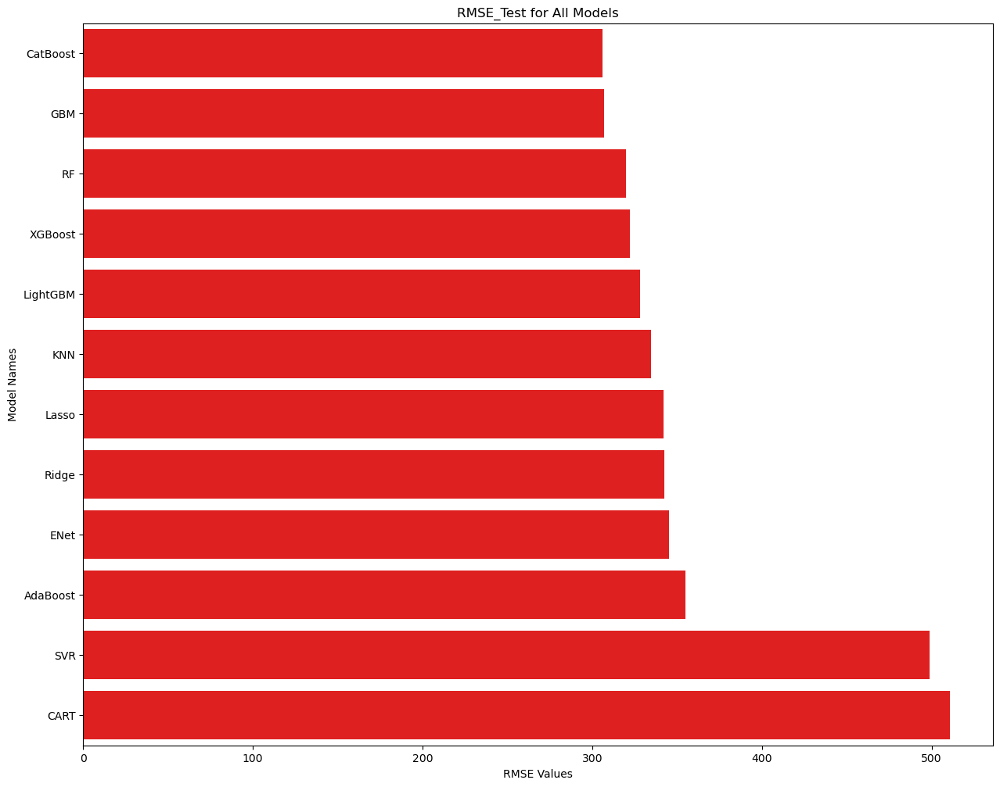

In [84]:
model_tuned_results = create_model_tuned(df, "Salary", plot=True, save_results=True)